<a href="https://colab.research.google.com/github/tamtamxtamtam/CV/blob/main/Camera.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
cd /content/drive/My Drive/2021_II/TGM/4/Chessboard

/content/drive/My Drive/2021_II/TGM/4/Chessboard


In [4]:
pwd

'/content/drive/My Drive/2021_II/TGM/4/Chessboard'

In [5]:
import cv2

# read image
img = cv2.imread('1.jpg')

# image dimension
print('img.shape:', img.shape)

img.shape: (1920, 2560, 3)


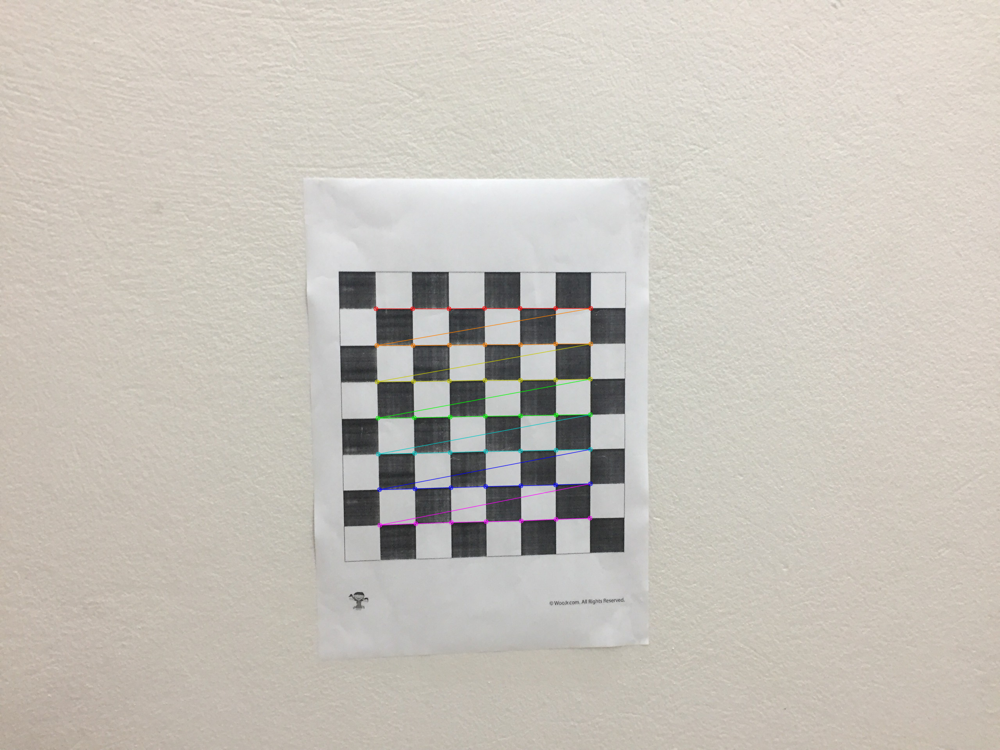

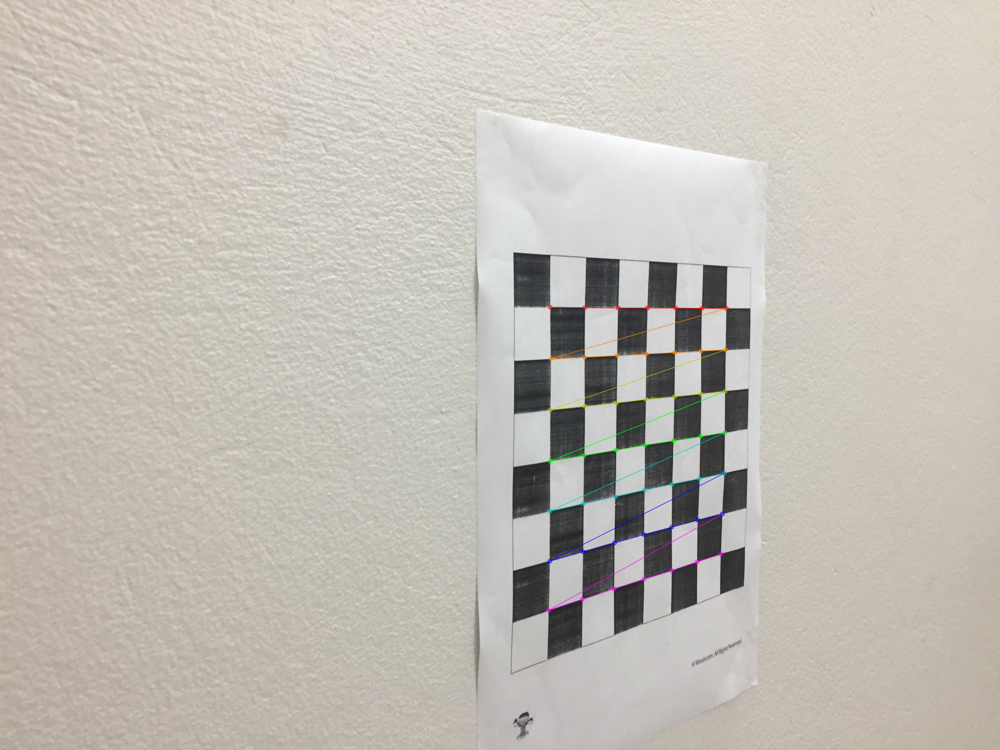

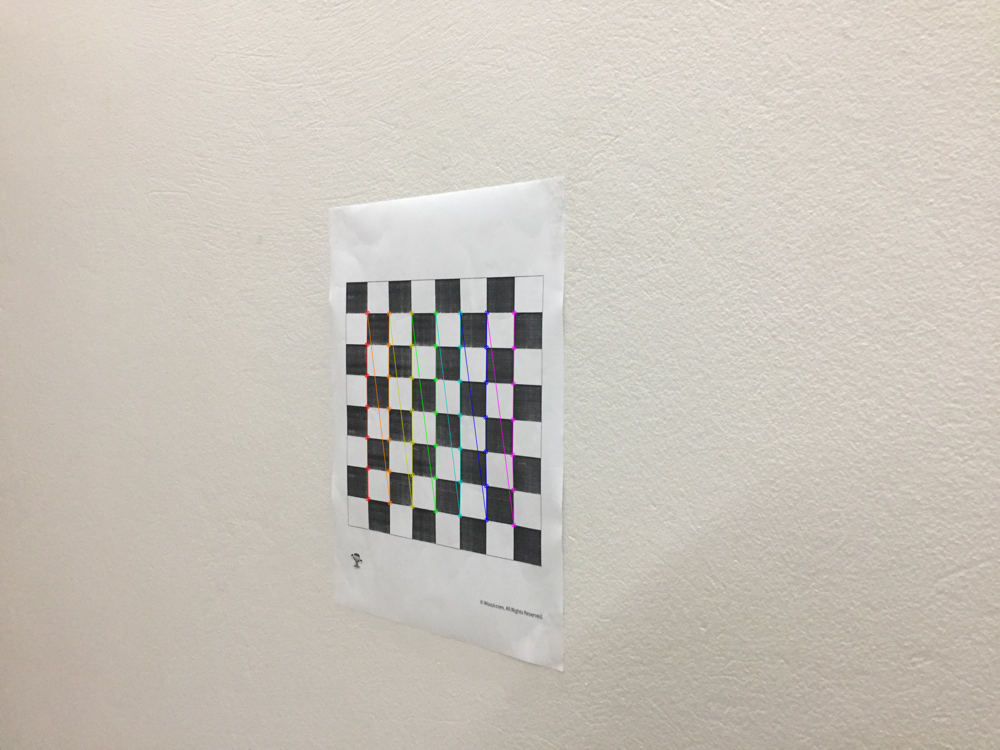

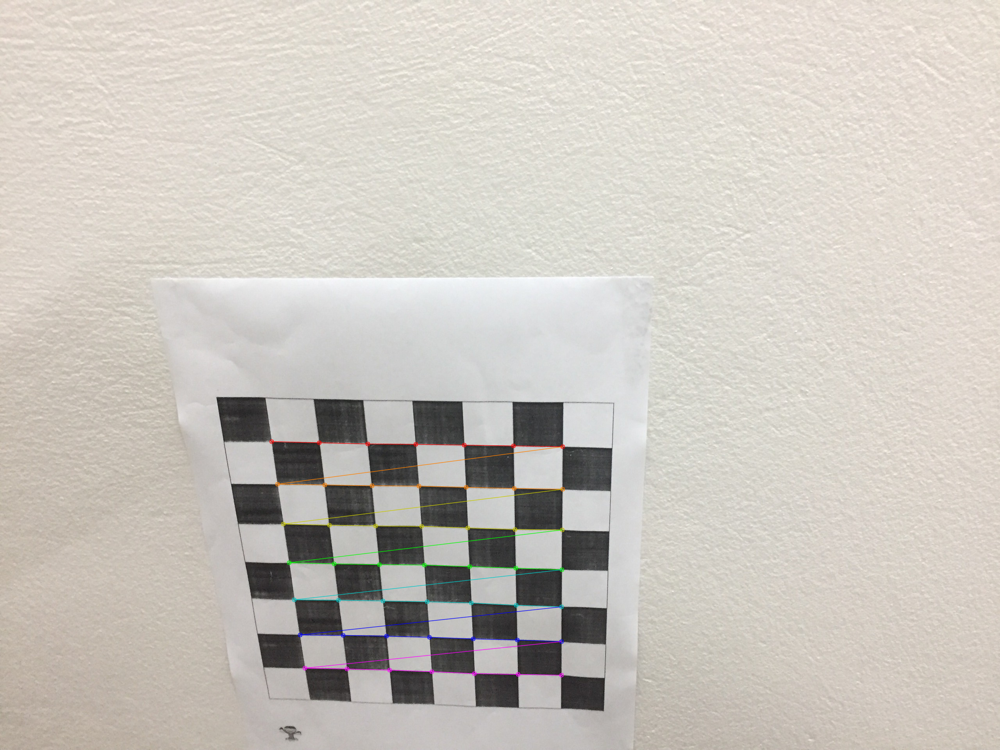

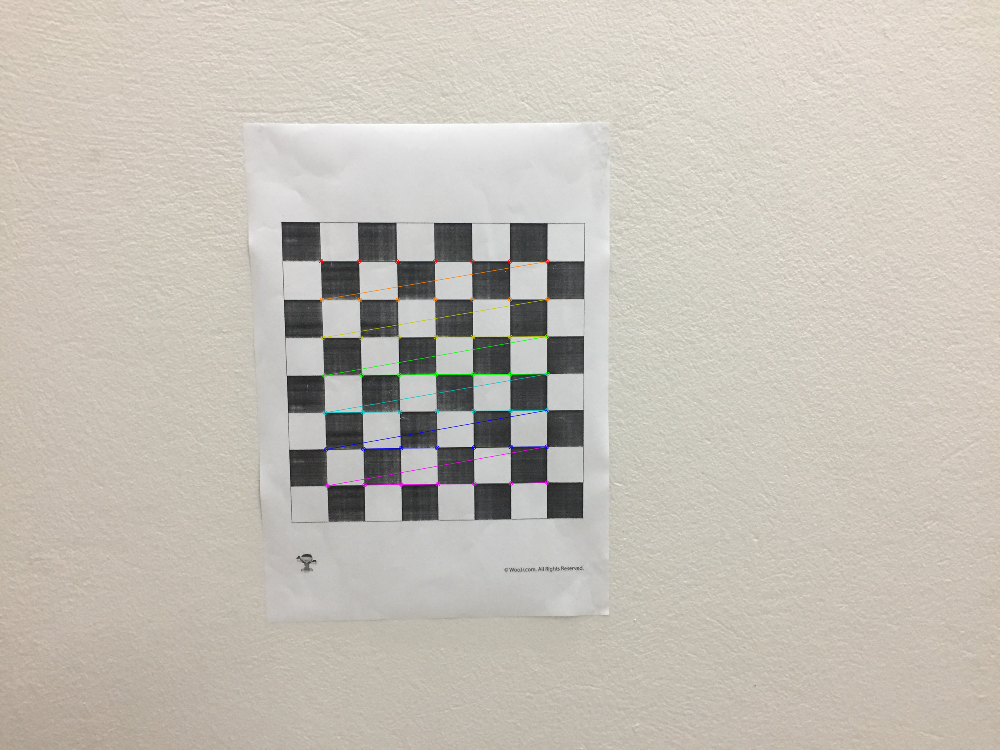

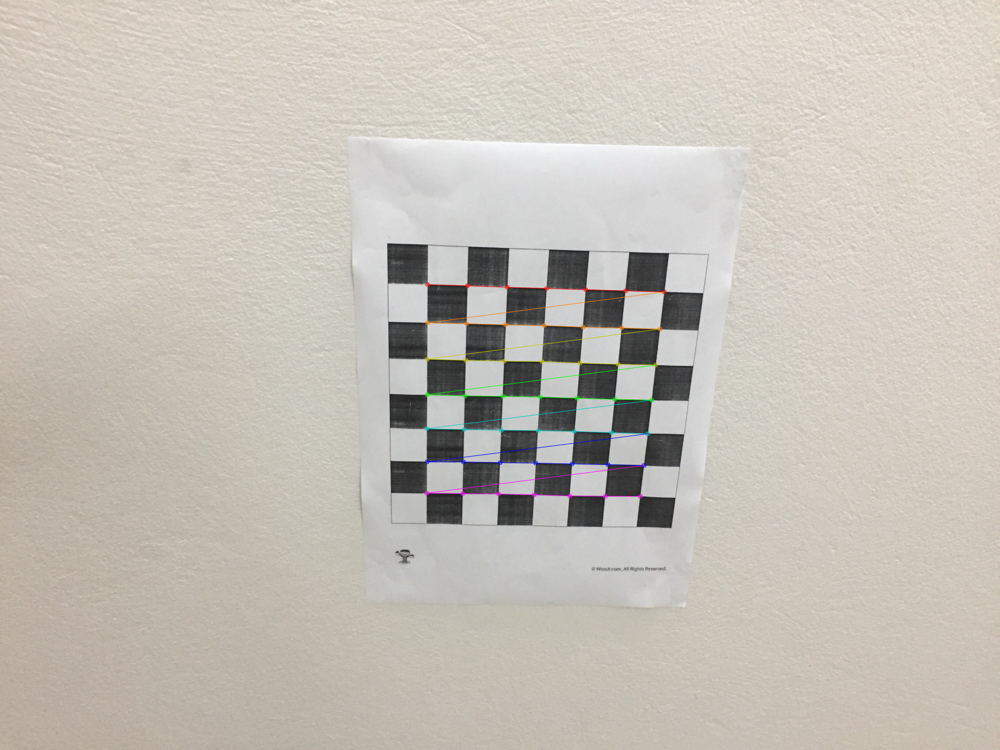

translation vector size 6
rotation vector size 6
translation 
 [array([[-4.18260411],
       [-2.06982201],
       [24.02404618]]), array([[ 0.4429422 ],
       [-1.49849972],
       [17.06907121]]), array([[-5.23256789],
       [ 3.69360425],
       [28.58542328]]), array([[-5.28502565],
       [ 1.16522981],
       [17.98689555]]), array([[-5.46827432],
       [-3.23144557],
       [23.04953394]]), array([[-2.51444339],
       [-2.48624354],
       [21.86922863]])]
rotation 
 [array([[ 0.09454356],
       [-0.11535197],
       [-0.00816554]]), array([[ 0.08477717],
       [-0.75949438],
       [-0.02884505]]), array([[-0.45003844],
       [ 0.5496351 ],
       [-1.48377222]]), array([[0.44686037],
       [0.0484801 ],
       [0.00299314]]), array([[ 0.12831886],
       [-0.05366615],
       [-0.00397641]]), array([[ 0.42069267],
       [-0.06427012],
       [ 0.03819216]])]
Camera parameters = [[ 2.32672479e+03  4.36795041e+02  1.10850139e+03  2.39128505e+04]
 [ 1.22714200e+02  2.458

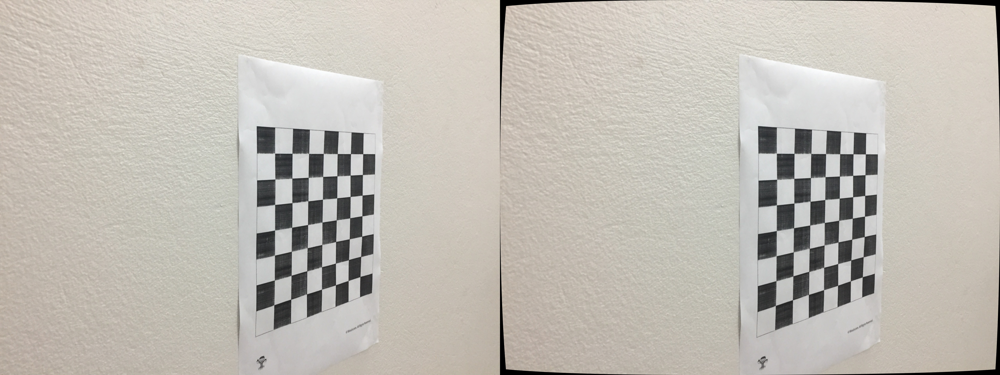

In [9]:
import numpy as np
import cv2
import glob

from google.colab.patches import cv2_imshow

# Define the chess board rows and columns
rows = 7
cols = 7

# Set the termination criteria for the corner sub-pixel algorithm
criteria = (cv2.TERM_CRITERIA_MAX_ITER + cv2.TERM_CRITERIA_EPS, 30, 0.001)

# Prepare the object points: (0,0,0), (1,0,0), (2,0,0), ..., (6,5,0). They are the same for all images
objectPoints = np.zeros((rows * cols, 3), np.float32)
objectPoints[:, :2] = np.mgrid[0:rows, 0:cols].T.reshape(-1, 2)

# Create the arrays to store the object points and the image points
objectPointsArray = []
imgPointsArray = []

# Loop over the image files
for path in glob.glob('*.jpg'):
    # Load the image and convert it to gray scale
    img = cv2.imread(path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Find the chess board corners
    ret, corners = cv2.findChessboardCorners(gray, (rows, cols), None)

    # Make sure the chess board pattern was found in the image
    if ret:
        # Refine the corner position
        corners = cv2.cornerSubPix(gray, corners, (11, 11), (-1, -1), criteria)
        
        # Add the object points and the image points to the arrays
        objectPointsArray.append(objectPoints)
        imgPointsArray.append(corners)

        # Draw the corners on the image
        cv2.drawChessboardCorners(img, (rows, cols), corners, ret)
    
    # Display the image
    cv2_imshow(img)
    cv2.waitKey(500)

# Calibrate the camera and save the results
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objectPointsArray, imgPointsArray, gray.shape[::-1], None, None)
#ret, mtx,dis, rvecs, tvecs = cv2.calibrateCamera(threedpoints,twodpoints,(h,w),None,None)
np.savez('../calib.npz', mtx=mtx, dist=dist, rvecs=rvecs, tvecs=tvecs)
print("translation vector size",len(tvecs))
print("rotation vector size",len(rvecs))
print("translation \n",tvecs)
print("rotation \n",rvecs)
for rvec in rvecs:
    R_matrix, _ = cv2.Rodrigues(rvec)
for tvec in tvecs:
    Rt_matirx = np.concatenate((R_matrix, tvec), axis=1)
print("Camera parameters =", mtx.dot(Rt_matirx))
#Rt_matirx = np.concatenate((R_matrix, tvec), axis=1)
# Print the camera calibration error
error = 0

for i in range(len(objectPointsArray)):
    imgPoints, _ = cv2.projectPoints(objectPointsArray[i], rvecs[i], tvecs[i], mtx, dist)
    error += cv2.norm(imgPointsArray[i], imgPoints, cv2.NORM_L2) / len(imgPoints)

print("Total error: ", error / len(objectPointsArray))

# Load one of the test images
img = cv2.imread('2.jpg')
h, w = img.shape[:2]

# Obtain the new camera matrix and undistort the image
newCameraMtx, roi = cv2.getOptimalNewCameraMatrix(mtx, dist, (w, h), 1, (w, h))
undistortedImg = cv2.undistort(img, mtx, dist, None, newCameraMtx)

# Crop the undistorted image
# x, y, w, h = roi
# undistortedImg = undistortedImg[y:y + h, x:x + w]

# Display the final result
cv2_imshow(np.hstack((img, undistortedImg)))
cv2.waitKey(0)
cv2.destroyAllWindows()